## Result comparision of various denoising Deep Learning models on the AAPM Low Dose CT denoising dataset: 

## Implemented Models:
(i)     Hformer \
(ii)    MWCNN \
(iii)   Pridnet \
(iv)    WGAN-VGG

## Metrics Used:
(i)     PSNR \
(ii)    SSIM 

## Part I : Global includes



In [1]:

%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import os
import pathlib
from matplotlib import pyplot as plt
import numpy as np
import cv2
import tensorflow as tf

# Uncomment to disable GPU usage.
# This is required for some models like Pridnet which has too many traininable parameters
tf.config.set_visible_devices([], 'GPU')

from tqdm.notebook import tqdm
import random

import data_importer

In [2]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

## Part II : Loading test images

In [3]:
from sklearn.model_selection import train_test_split
from data_importer import load_training_images

noisy_array, gt_array = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data/', load_limited_images=True, num_images_to_load=10)

_n, _g = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Selected_Image_Pairs/', load_limited_images=False)

noisy_array = np.concatenate((noisy_array, _n), axis=0)
gt_array = np.concatenate((gt_array, _g), axis=0)

loaded training images x and y of len :  10 10  respectively
type of train images x :  float64
range of values in train images :  0.0 0.576171875
type of train images y :  float64
loaded training images x and y of len :  5 5  respectively
type of train images x :  float64
range of values in train images :  0.0 0.915283203125
type of train images y :  float64


In [4]:
print(noisy_array.shape)
print(gt_array.shape)

(15, 512, 512, 1)
(15, 512, 512, 1)


Visualization of the noisy / ground truth image pair

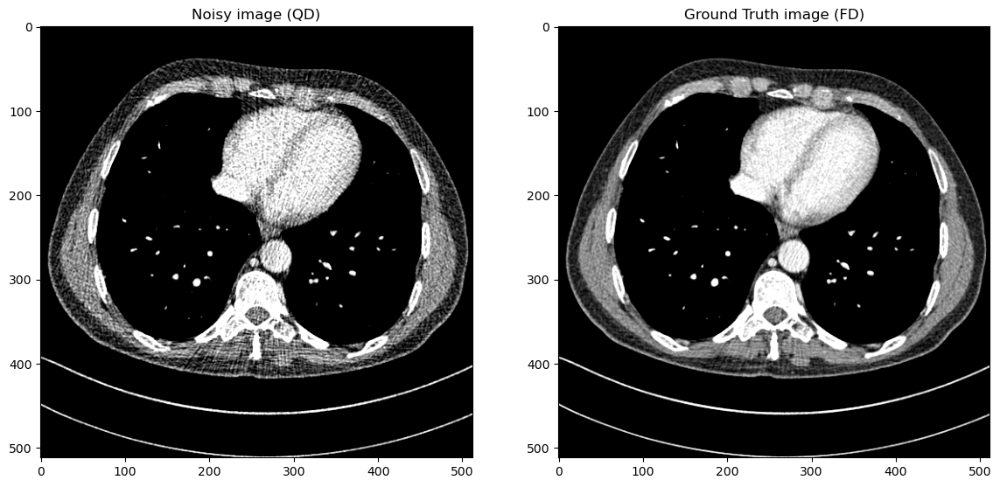

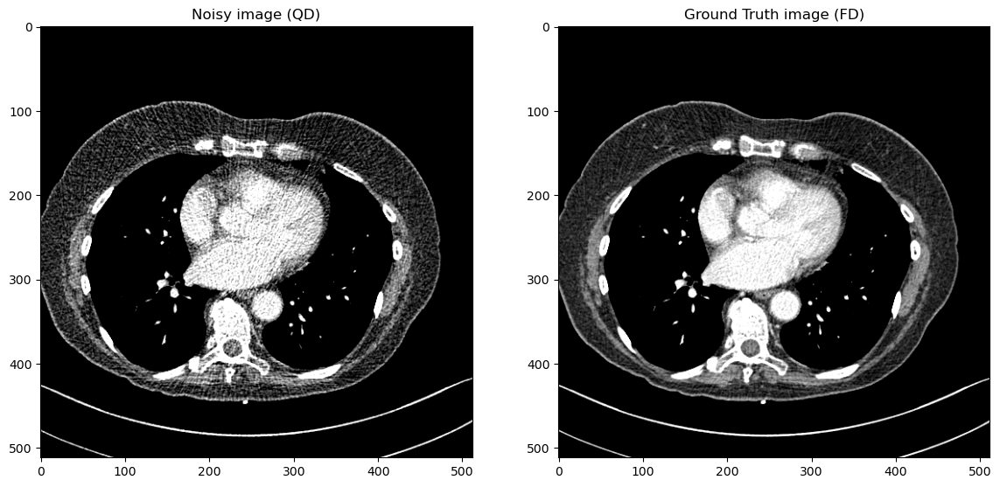

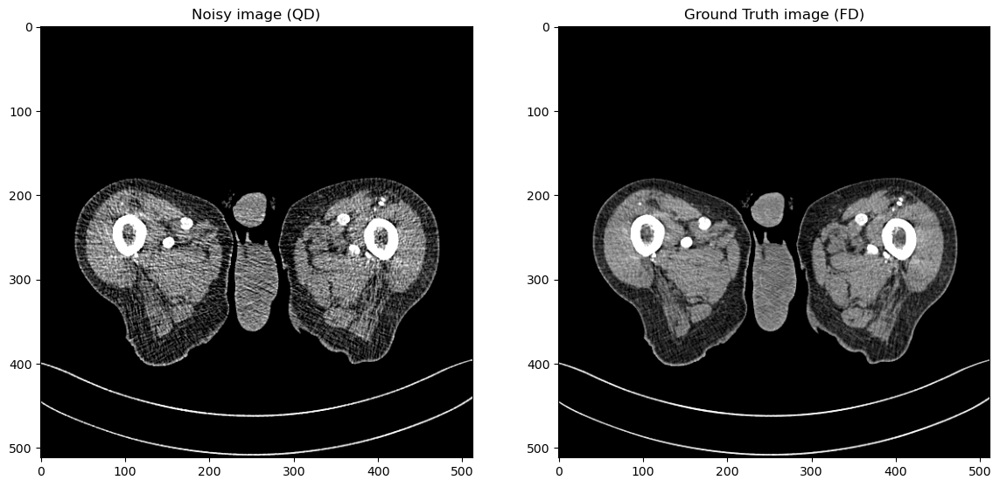

In [5]:
from data_importer import denormalize, trunc

for i in range(6, 15, 4):
    f, axarr = plt.subplots(1,2, figsize=(14,14))
    axarr[0].imshow(trunc(denormalize(noisy_array[i])), vmin=-160.0, vmax=240.0, cmap='gray')
    axarr[0].set_title("Noisy image (QD)")
    axarr[1].imshow(trunc(denormalize(gt_array[i])), vmin=-160.0, vmax=240.0, cmap='gray')
    axarr[1].title.set_text("Ground Truth image (FD)")
    plt.show()

### Part III : Setup for Inference

In [6]:
# Inference
def inference_single_image(model, noisy_image):
    input_image = np.expand_dims(noisy_image, axis=0)
    predicted_image = model.predict(input_image)
    a = np.abs(np.min(predicted_image))
    b = np.max(predicted_image)
    
    #predicted_image = predicted_image * (b - a) + a
    return predicted_image[0]

def inference_batch_images(model, noisy_images):
    input_image = noisy_images

    predicted_image = model.predict(input_image).astype(np.float64)
    return predicted_image

In [44]:
def rgb2gray(rgb):
    return np.expand_dims(np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140]), axis=-1)

from skimage.metrics import structural_similarity as ssim
import sys
sys.path.append('../')

from metrics import compute_SSIM, compute_PSNR

def calculate_psnr(original_image, reconstructed_image):
    return compute_PSNR(original_image, reconstructed_image, 240+160.0)

    psnr_value = peak_signal_noise_ratio(original_image, reconstructed_image, data_range=240+160)
    return psnr_value

def calculate_ssim(original_image, reconstructed_image):    
    ssim_value = ssim(original_image.astype(np.float64), reconstructed_image.astype(np.float64), win_size=5,  channel_axis=2, data_range=240+160)
    return ssim_value

def visualize_predictions(model, X_test, y_test, n, predictions, model_name):
    random_numbers = random.choices(range(X_test.shape[0]), k=n)    # Get n random indices
    for i in random_numbers:
        noisy_image = X_test[i]
        gt_image = y_test[i]
        predicted_image = predictions[i]
        
        #predicted_image = ((inference_single_image(model, X_test[i])).astype(np.float64))  

        
        if predicted_image.shape[-1] == 3:
            predicted_image = rgb2gray(predicted_image)
                                
        psnr_recon =  calculate_psnr(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
        psnr_qd =  calculate_psnr(trunc(denormalize(gt_image)),  trunc(denormalize(noisy_image)))
        ssim_recon = calculate_ssim(trunc(denormalize(gt_image)),  trunc(denormalize(predicted_image)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        
        psnr_recon = round(psnr_recon, 4)
        psnr_qd = round(psnr_qd, 4)
        ssim_recon = round(ssim_recon, 4)
        ssim_qd = round(ssim_qd, 4)
        
        print(predicted_image.shape, noisy_image.shape)       
        f, axarr = plt.subplots(1,3, figsize=(21,21))

        axarr[0].imshow(trunc(denormalize(noisy_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[0].set_title("QD Image : PSNR={}, SSIM={}".format(psnr_qd, ssim_qd))
        axarr[0].set_axis_off()
        axarr[1].imshow(trunc(denormalize(gt_image)),  cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[1].set_title("FD Image")
        axarr[1].set_axis_off()
        axarr[2].imshow(trunc(denormalize(predicted_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[2].set_title("{} Predicted Image : PSNR={}, SSIM={}".format(model_name, psnr_recon, ssim_recon))
        axarr[2].set_axis_off()
        
        plt.show()

In [8]:
from skimage.metrics import peak_signal_noise_ratio

def get_average_metrics(predicted_images):
    psnr_original_mean = 0
    psnr_prediction_mean = 0

    ssim_original_mean = 0
    ssim_prediction_mean = 0

    i = 0
    for gt_img, noisy_img, predicted_img in zip(gt_array, noisy_array, predicted_images):
        predicted_img=  predicted_images[i]
        if predicted_img.shape[-1] == 3:
            predicted_img = rgb2gray(predicted_img)
            
        psnr_recon =  calculate_psnr(trunc(denormalize(gt_img)), trunc(denormalize(predicted_img)))
        psnr_qd =  calculate_psnr(trunc(denormalize(gt_img)),  trunc(denormalize(noisy_img)))
        ssim_recon = calculate_ssim(trunc(denormalize(gt_img)),  trunc(denormalize(predicted_img)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_img)), trunc(denormalize(noisy_img)))

        psnr_original_mean += psnr_qd
        psnr_prediction_mean += psnr_recon
        
        ssim_original_mean += ssim_qd
        ssim_prediction_mean += ssim_recon
        
        i = i + 1        
    
    psnr_original_mean/=gt_array.shape[0]
    psnr_prediction_mean/=gt_array.shape[0]

    ssim_original_mean/=gt_array.shape[0]
    ssim_prediction_mean/=gt_array.shape[0]
    
    print("Original average gt-noisy PSNR ->", psnr_original_mean)
    print("Predicted average gt-predicted PSNR ->", psnr_prediction_mean)

    print("Original average gt-noisy SSIM ->", ssim_original_mean)
    print("Predicted average gt-predicted SSIM ->", ssim_prediction_mean)
    


In [9]:
def view_model_history(history, model_name):
    # Visualize model history.
    # Plot loss, accuracy, val_loss and val_accuracy
    print('available keys in model history : ', history.keys())    
    
    num_epochs = len(history['loss'])

    print('Model history for : ', model_name)
    
    # Plot training and validation accuracy / PSNR values
    if 'accuracy' in history.keys():
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['accuracy'], label='Training Accuracy')
        plt.plot(range(1, num_epochs + 1), history['val_accuracy'], label='Validation Accuracy')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
    
    if 'psnr' in history.keys():
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), history['psnr'], label='Training psnr')
        plt.plot(range(1, num_epochs + 1), history['val_psnr'], label='Validation psnr')
        plt.title('Training and Validation Psnr')
        plt.xlabel('Epoch')
        plt.ylabel('Psnr')
        plt.legend()
        
    # Plot training and validation loss values
    if 'loss' in history.keys():
        plt.plot(range(1, num_epochs + 1), history['loss'], label='Training Loss')
        plt.plot(range(1, num_epochs + 1), history['val_loss'], label='Validation Loss')
        plt.title('Training and Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
    
    plt.tight_layout()
    plt.show()

## Evaluation of each model

## Model 1 : Hformer

In [10]:
sys.path.append('../denoising-models/hformer_vit/model/')
sys.path.append('../denoising-models/hformer_vit/')
from hformer_model_extended import get_hformer_model, PatchExtractor

hformer_model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended")
hformer_model.build(input_shape=(None, 64, 64, 1))
hformer_model.load_weights('../denoising-models/hformer_vit/test/experiments/full_dataset/hformer_64_channel_custom_loss_epochs_48.h5')
print('Model summary : ')
print(hformer_model.summary())

Model summary : 
Model: "hformer_model_extended"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv

In [11]:
def reconstruct_image_from_patches(patches, num_patches_per_row):
    patch_size = patches.shape[1]  # Assuming square patches
    num_patches = patches.shape[0]

    # Calculate the number of rows
    num_patches_per_col = num_patches // num_patches_per_row

    # Initialize an empty image to store the reconstructed result
    reconstructed_image = np.zeros((num_patches_per_col * patch_size, num_patches_per_row * patch_size))

    # Reshape the patches into a 2D array
    patches_2d = patches.reshape((num_patches_per_col, num_patches_per_row, patch_size, patch_size))

    # Reconstruct the image by placing each patch in its corresponding position
    for i in range(num_patches_per_col):
        for j in range(num_patches_per_row):
            reconstructed_image[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size] = patches_2d[i, j]

    return np.expand_dims(reconstructed_image, axis=-1)

In [12]:
# View the predictions
patch_extractor = PatchExtractor(patch_size=64, stride=64, name="patch_extractor")
noisy_image_patches_array = patch_extractor(noisy_array)

hformer_prediction_patches = hformer_model.predict(noisy_image_patches_array)

30/30 [==============================] - 47s 2s/step


In [13]:
hformer_predictions = np.expand_dims(reconstruct_image_from_patches(hformer_prediction_patches[0:64], 8), axis=0)

print(hformer_predictions.shape)

for i in range(1, int(hformer_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(hformer_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    hformer_predictions = np.append(hformer_predictions, reconstructed_image, axis=0)

print(hformer_predictions.shape)


(1, 512, 512, 1)
(15, 512, 512, 1)


(512, 512, 1) (512, 512, 1)


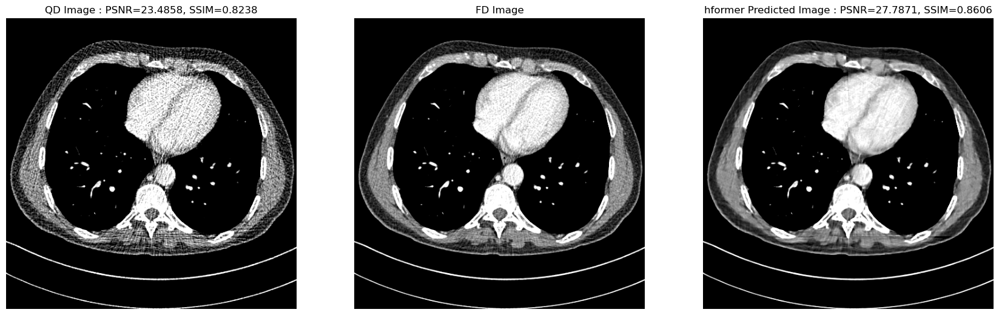

(512, 512, 1) (512, 512, 1)


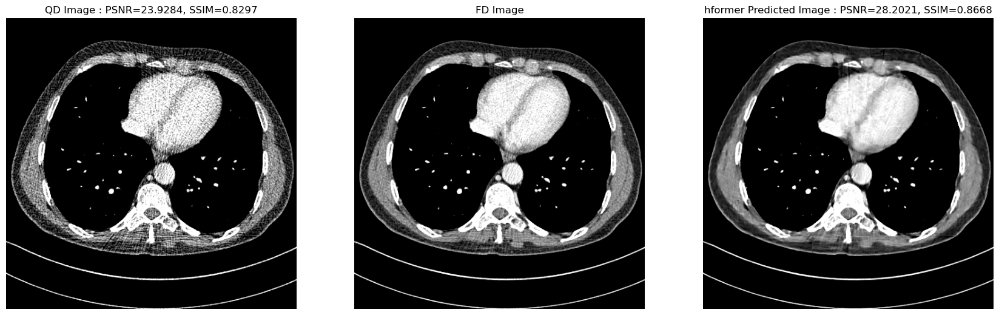

(512, 512, 1) (512, 512, 1)


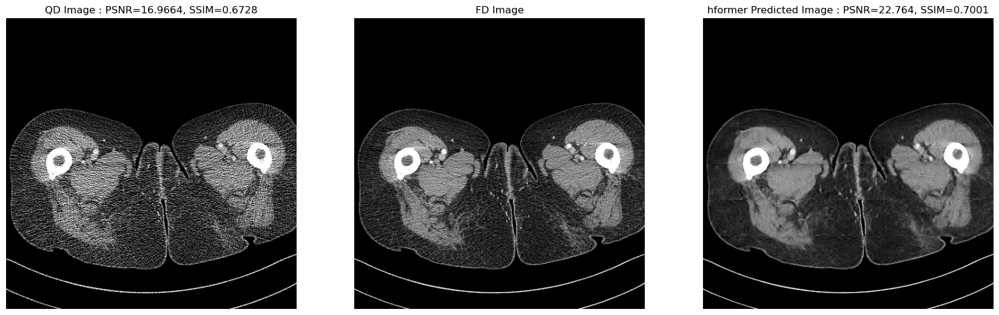

(512, 512, 1) (512, 512, 1)


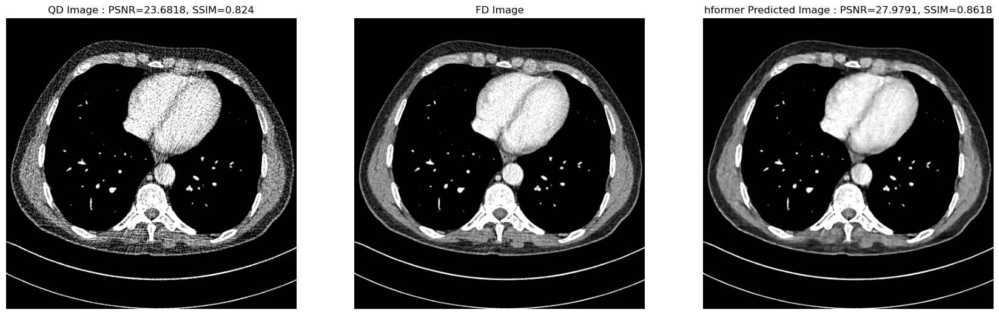

(512, 512, 1) (512, 512, 1)


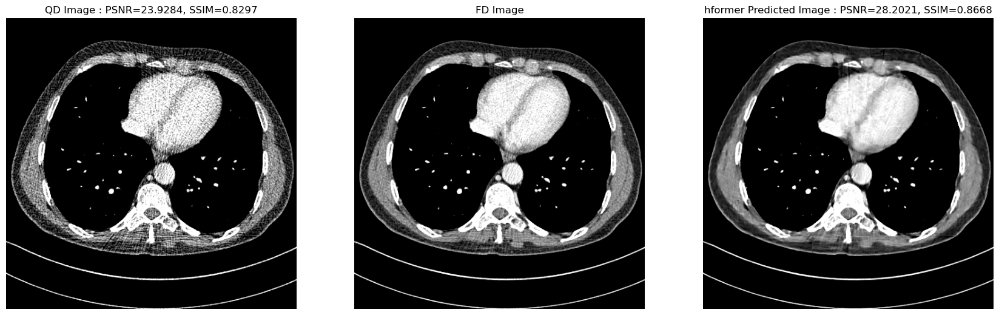

(512, 512, 1) (512, 512, 1)


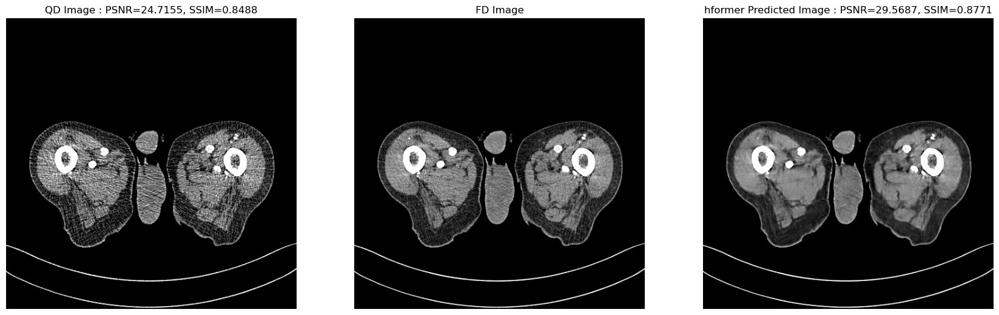

(512, 512, 1) (512, 512, 1)


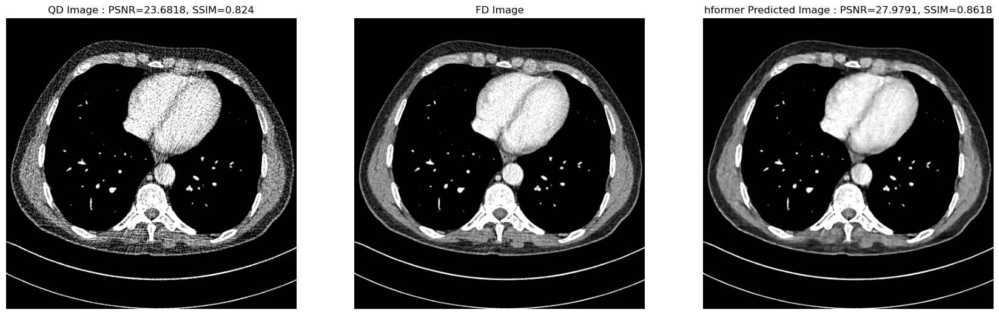

(512, 512, 1) (512, 512, 1)


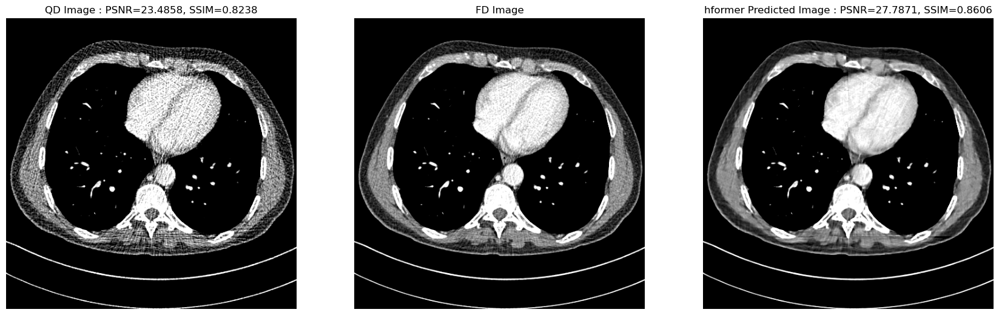

(512, 512, 1) (512, 512, 1)


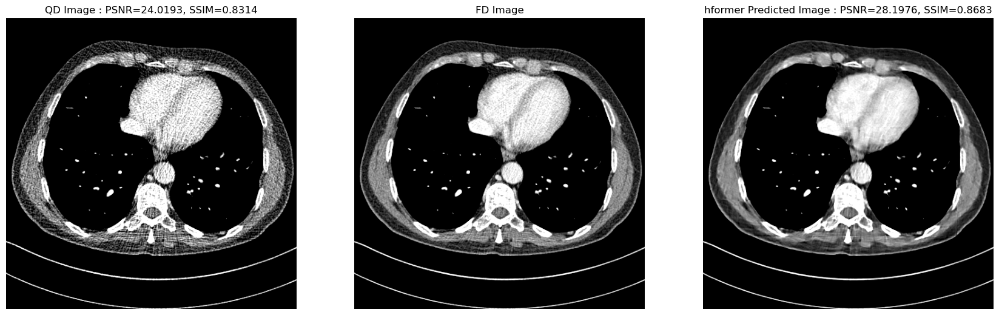

(512, 512, 1) (512, 512, 1)


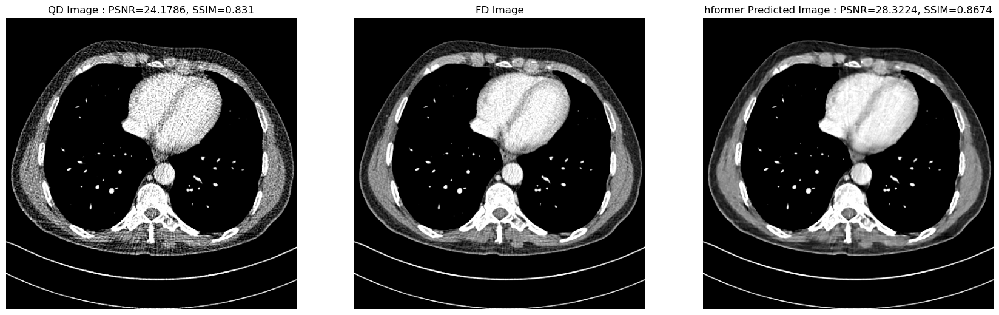

(512, 512, 1) (512, 512, 1)


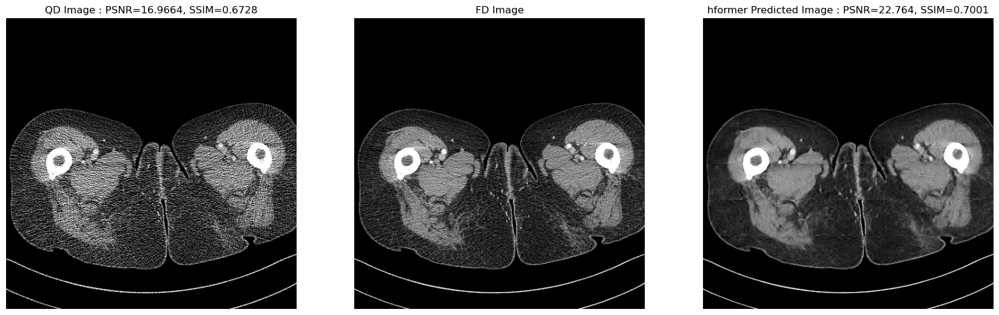

(512, 512, 1) (512, 512, 1)


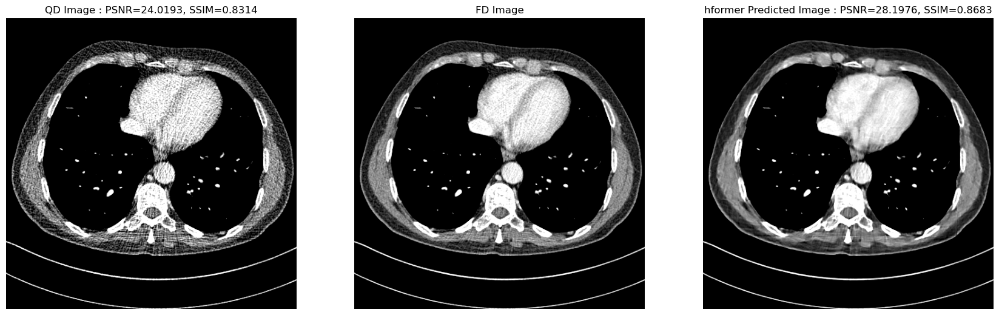

(512, 512, 1) (512, 512, 1)


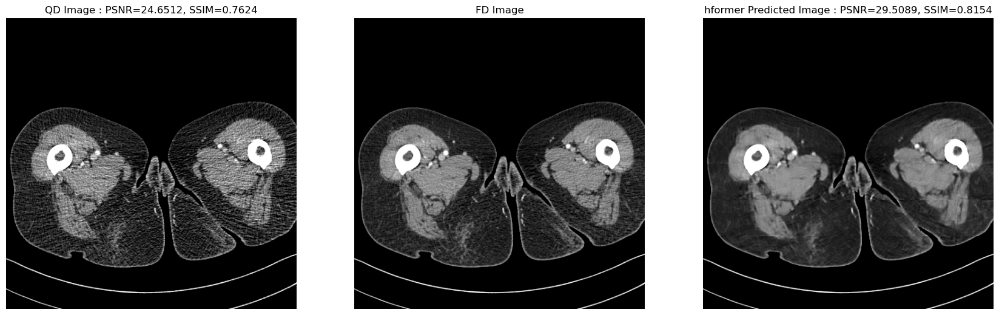

(512, 512, 1) (512, 512, 1)


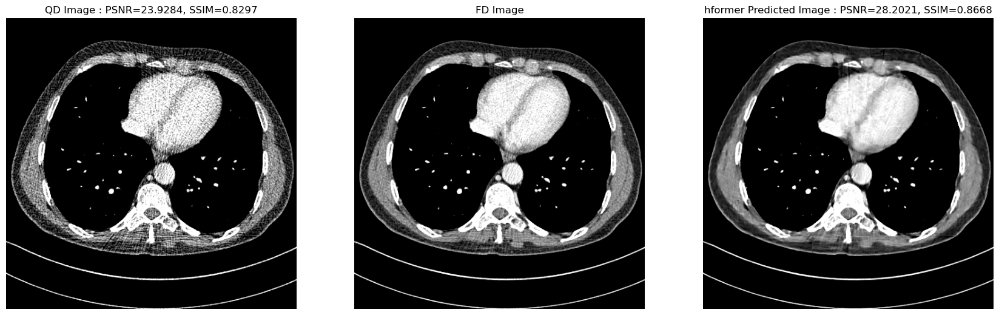

(512, 512, 1) (512, 512, 1)


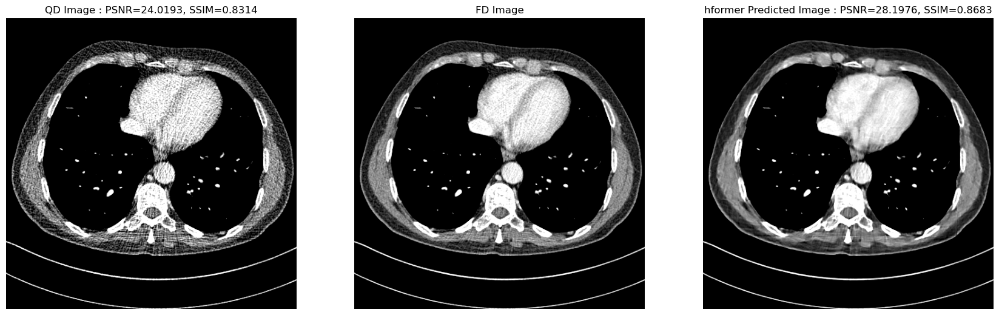

In [14]:
visualize_predictions(hformer_model, noisy_array, gt_array, len(gt_array), hformer_predictions, "hformer")

In [15]:
get_average_metrics(hformer_predictions)

Original average gt-noisy PSNR -> 23.5987675969538
Predicted average gt-predicted PSNR -> 28.064710297928595
Original average gt-noisy SSIM -> 0.8120425476373619
Predicted average gt-predicted SSIM -> 0.8488678973475837


## Model 2 : Pridnet

In [40]:
sys.path.append('../denoising-models/pridnet/')
from pridnet_model import get_pridnet_model

pridnet_model = get_pridnet_model()
pridnet_model.load_weights('../denoising-models/pridnet/data/pridnet_saved.h5')
print('Model summary : ')
print(pridnet_model.summary())

Input = (None, 256, 256, 1)
Conv block = (None, 256, 256, 64)
Channel Attention = (None, 256, 256, 64)
Channel Attention Last CNN = (None, 256, 256, 3)
First phase = (None, 256, 256, 4)

Multi-scale feature extraction = (None, 256, 256, 19)
Kernel Selection Module = (None, 256, 256, 3)
Model summary : 
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_layer (InputLayer)       [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 convolutional_block (Convoluti  (None, 256, 256, 64  111424     ['input_layer[0][0]']            
 onal_block)                    )                                                      

In [41]:
# Get prediction images.
import cv2
resized_noisy_array = []

for img in noisy_array:
    resized_img = cv2.resize(img, (256, 256), interpolation=cv2.INTER_AREA )
    resized_noisy_array.append(resized_img)

resized_noisy_array = np.array(resized_noisy_array)
pridnet_predictions_256x256 = pridnet_model.predict(resized_noisy_array)

pridnet_predictions = []
for img in pridnet_predictions_256x256:
    resized_img = cv2.resize(img, (512, 512), interpolation=cv2.INTER_CUBIC ).astype(np.float64)
    pridnet_predictions.append(resized_img)

1/1 [==============================] - 13s 13s/step


(512, 512, 1) (512, 512, 1)


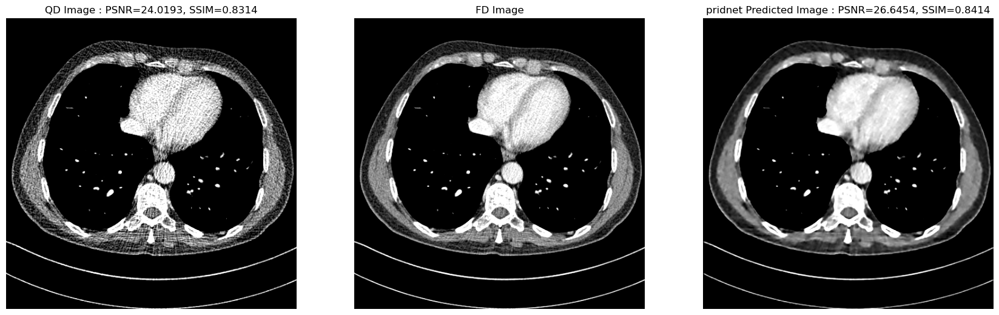

(512, 512, 1) (512, 512, 1)


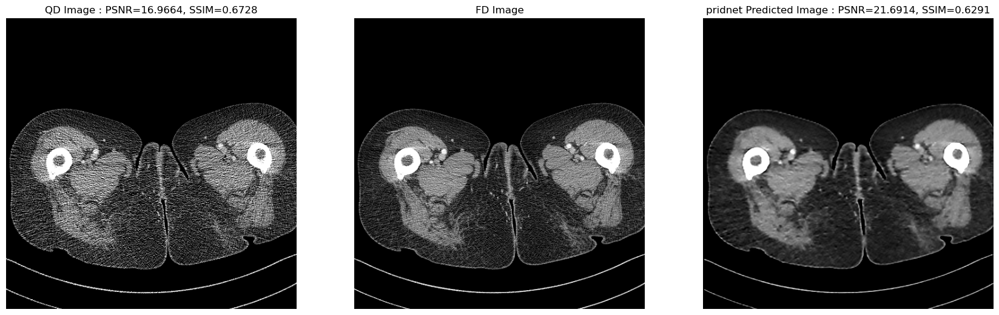

(512, 512, 1) (512, 512, 1)


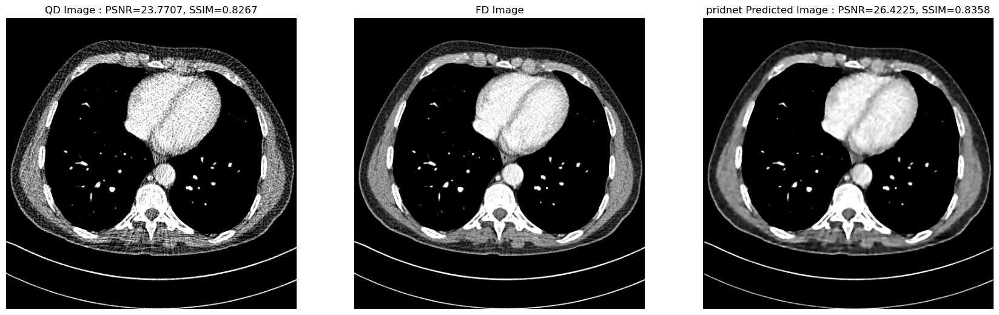

(512, 512, 1) (512, 512, 1)


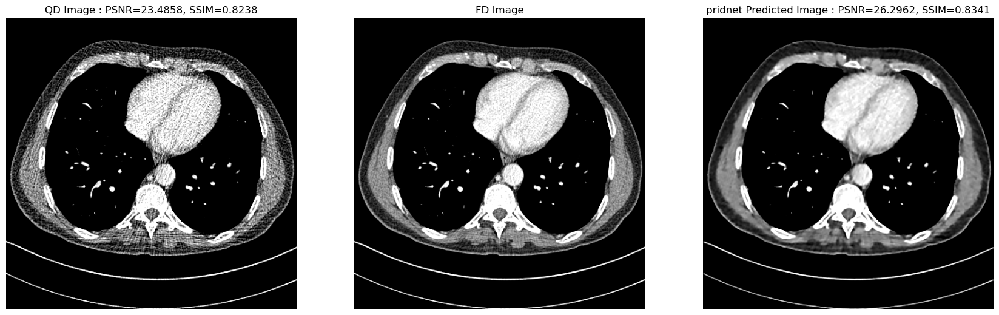

(512, 512, 1) (512, 512, 1)


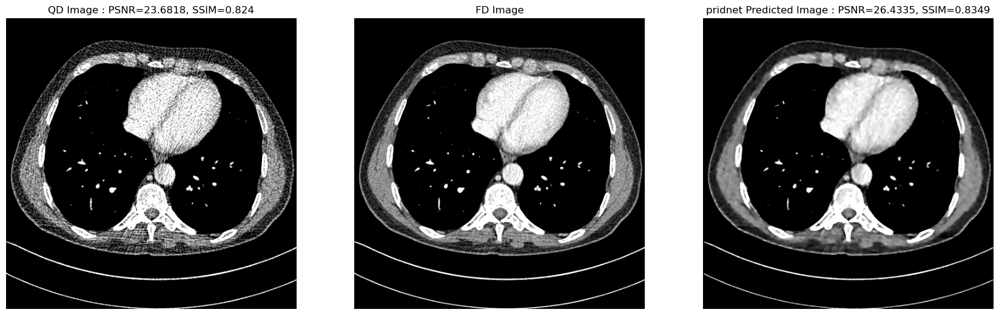

(512, 512, 1) (512, 512, 1)


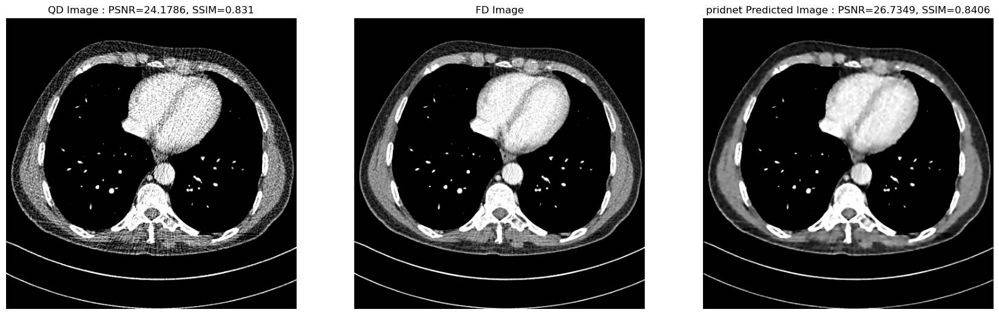

(512, 512, 1) (512, 512, 1)


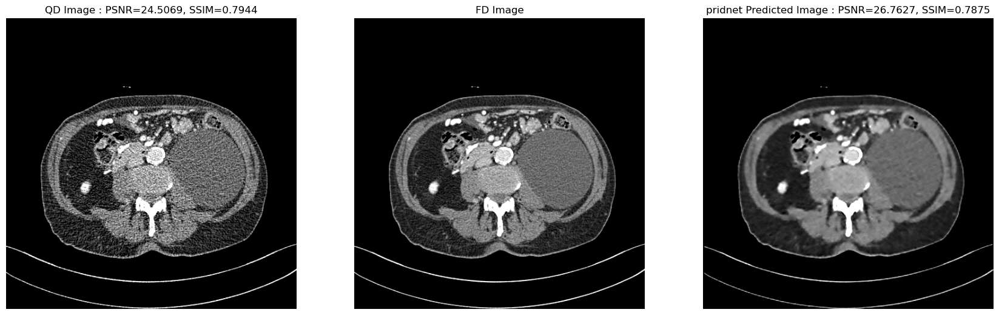

(512, 512, 1) (512, 512, 1)


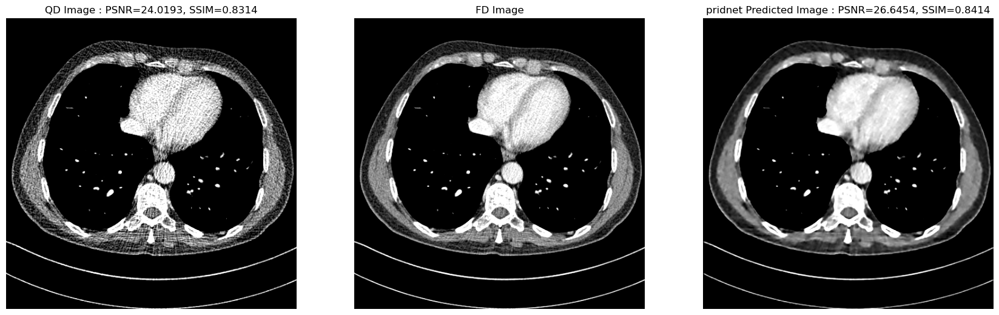

(512, 512, 1) (512, 512, 1)


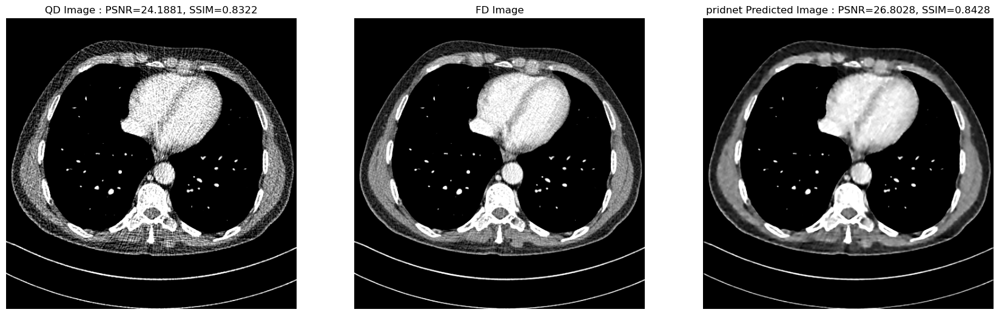

(512, 512, 1) (512, 512, 1)


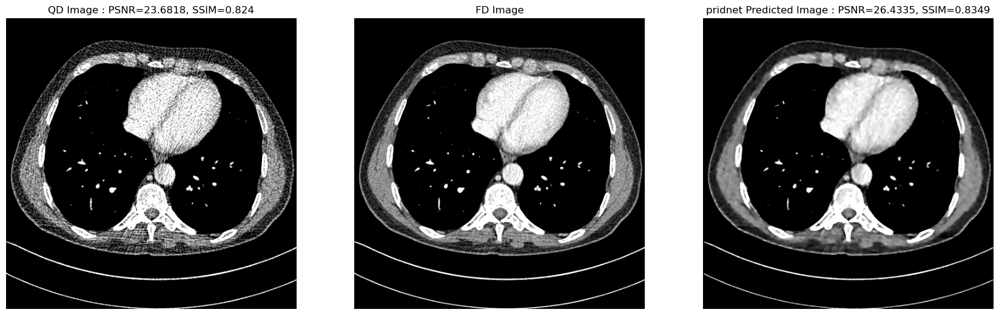

(512, 512, 1) (512, 512, 1)


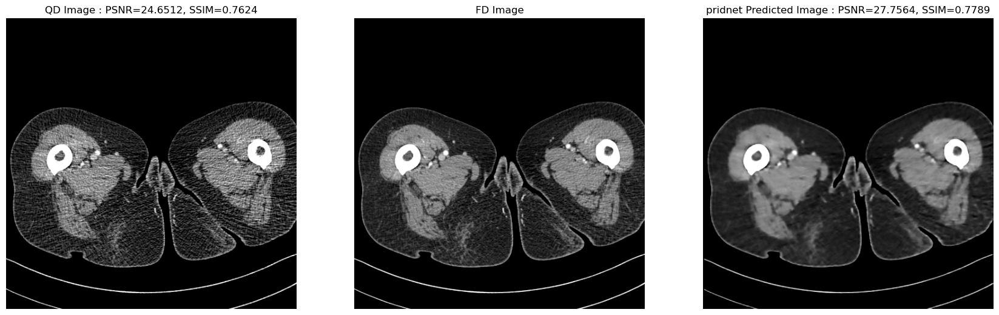

(512, 512, 1) (512, 512, 1)


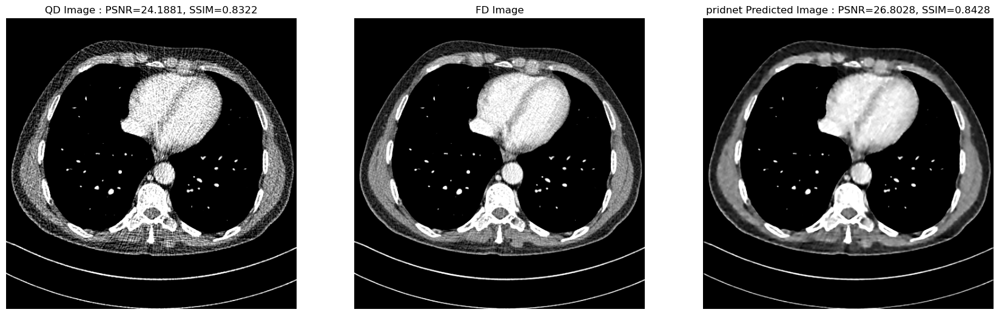

(512, 512, 1) (512, 512, 1)


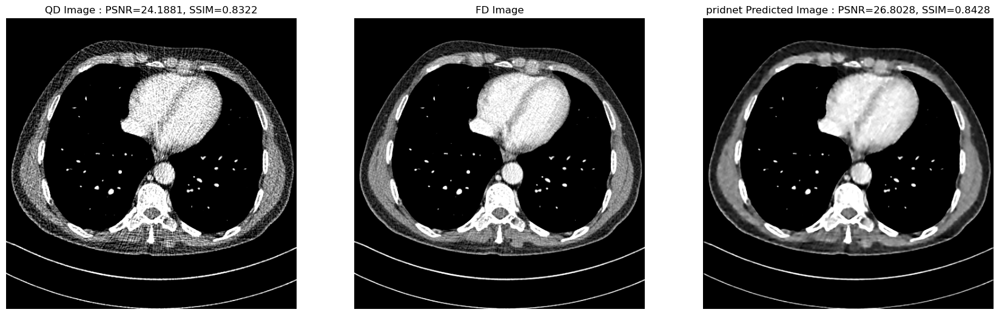

(512, 512, 1) (512, 512, 1)


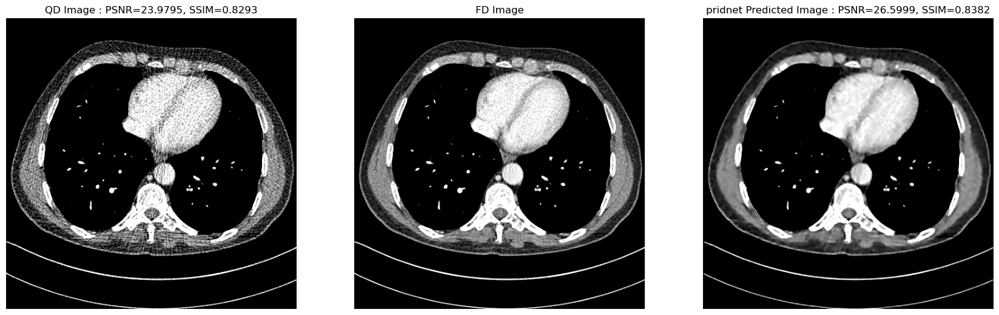

(512, 512, 1) (512, 512, 1)


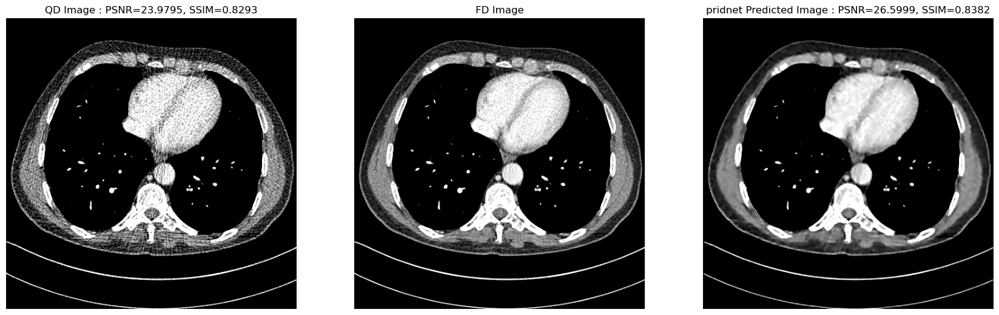

In [45]:
visualize_predictions(pridnet_model, noisy_array, gt_array, len(gt_array), pridnet_predictions, "pridnet")

In [46]:
get_average_metrics(pridnet_predictions)

Original average gt-noisy PSNR -> 23.5987675969538
Predicted average gt-predicted PSNR -> 26.394280962250647
Original average gt-noisy SSIM -> 0.8120425476373619
Predicted average gt-predicted SSIM -> 0.8160549726424936


## Model 3 : MWCNN

In [48]:
sys.path.append('../denoising-models/mwcnn/')
from mwcnn_model import get_mwcnn_model

mwcnn_model = get_mwcnn_model()
mwcnn_model.load_weights('../denoising-models/mwcnn/data/mwcnn_epochs_01.h5')
print('Model summary : ')
print(mwcnn_model.summary())

Model summary : 
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv_block (Conv_block)        (None, 256, 256, 64  74496       ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 dwt_downsampling (DWT_downsamp  (None, 128, 128, 25  0          ['conv_block[0][0]']             
 ling)                          6)                                           

In [56]:
# Get prediction images.

mwcnn_predictions_256x256 = mwcnn_model.predict(resized_noisy_array)

mwcnn_predictions = []
for img in mwcnn_predictions_256x256:
    resized_img = cv2.resize(img, (512, 512), interpolation=cv2.INTER_CUBIC ).astype(np.float64)
    mwcnn_predictions.append(np.expand_dims(resized_img, axis=-1))

1/1 [==============================] - 9s 9s/step


(512, 512, 1) (512, 512, 1)


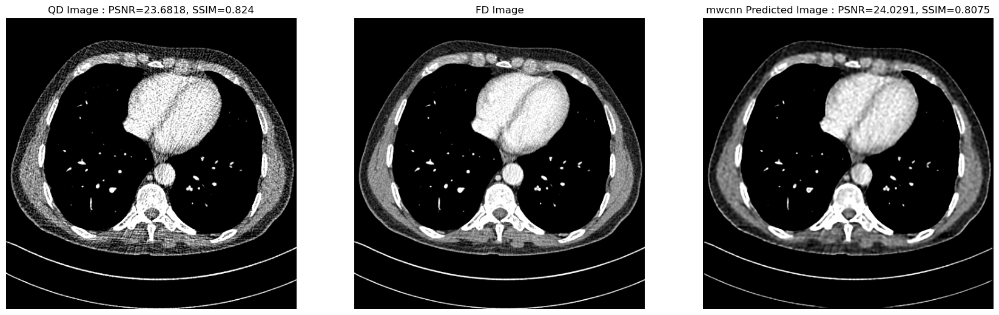

(512, 512, 1) (512, 512, 1)


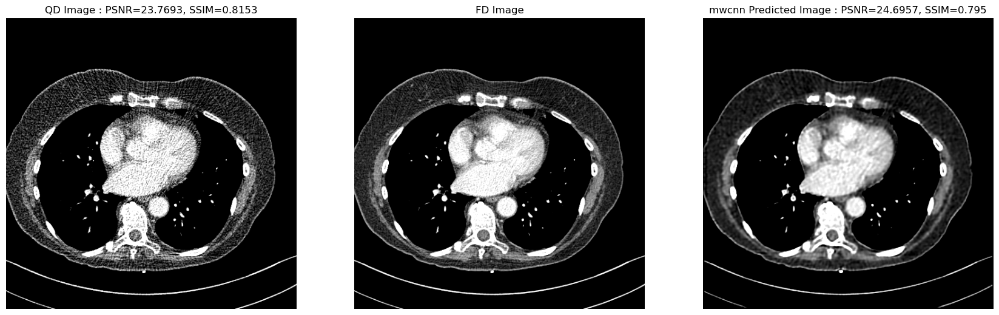

(512, 512, 1) (512, 512, 1)


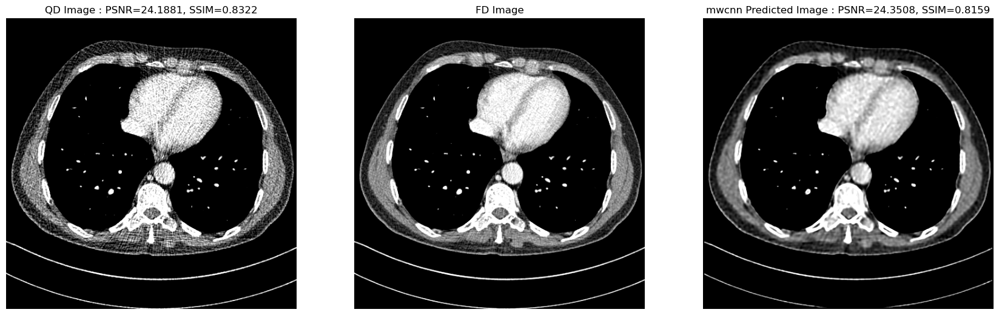

(512, 512, 1) (512, 512, 1)


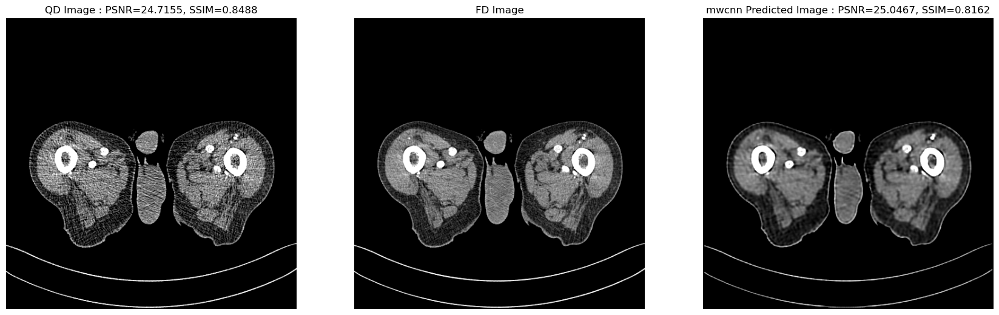

(512, 512, 1) (512, 512, 1)


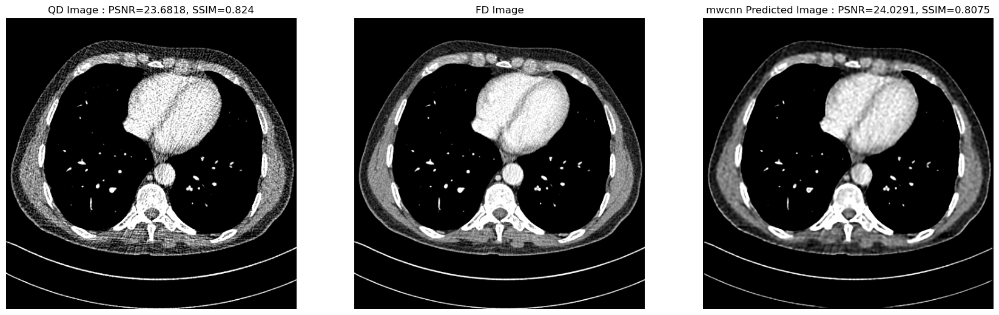

(512, 512, 1) (512, 512, 1)


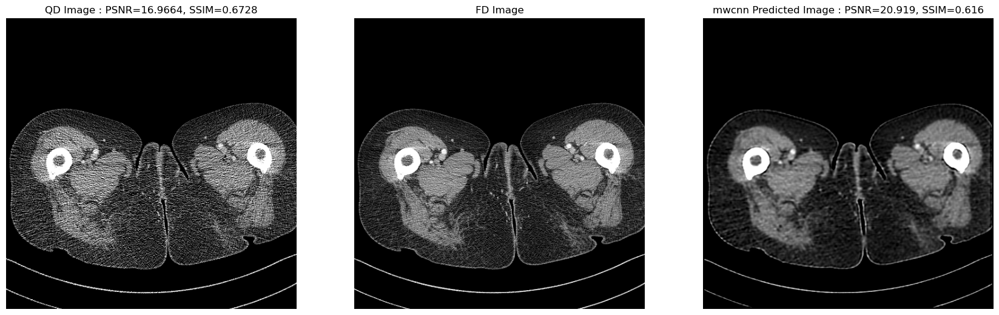

(512, 512, 1) (512, 512, 1)


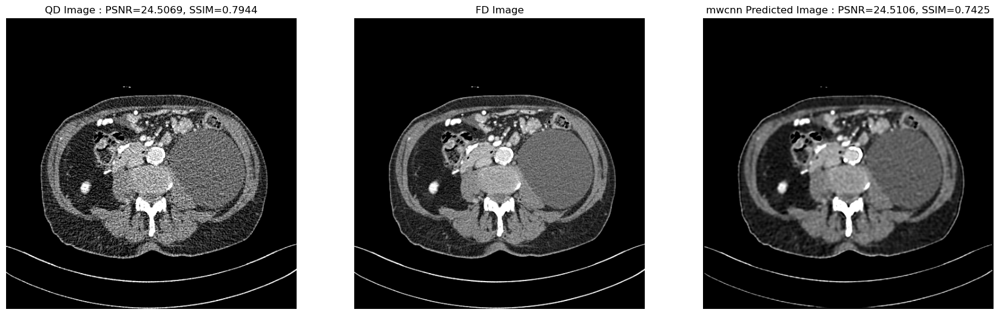

(512, 512, 1) (512, 512, 1)


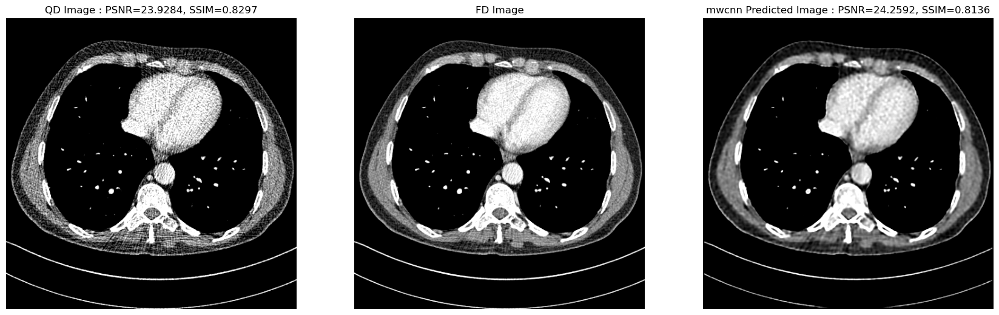

(512, 512, 1) (512, 512, 1)


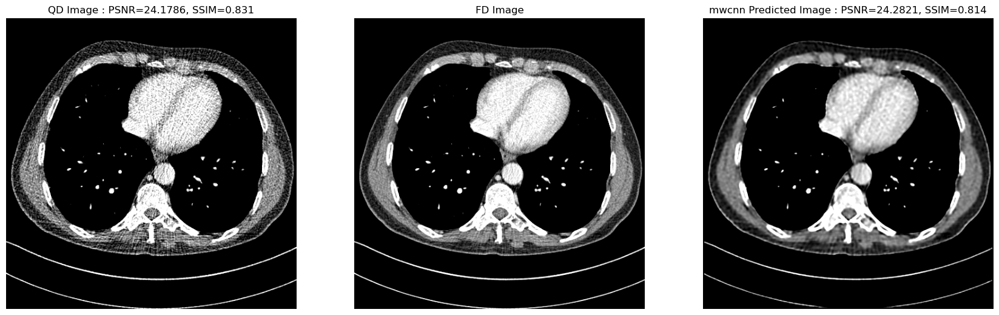

(512, 512, 1) (512, 512, 1)


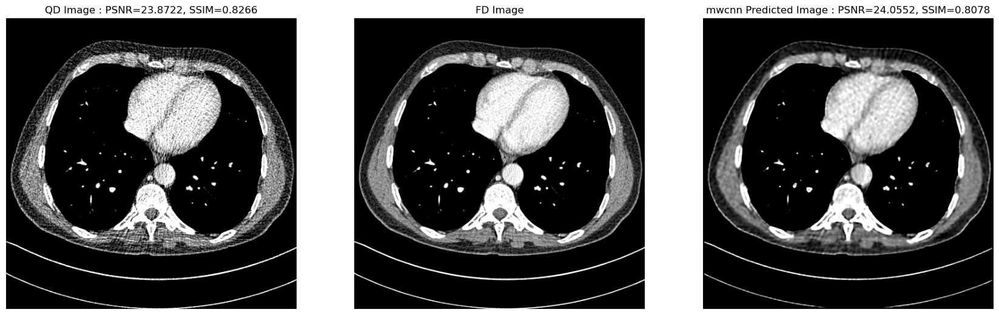

(512, 512, 1) (512, 512, 1)


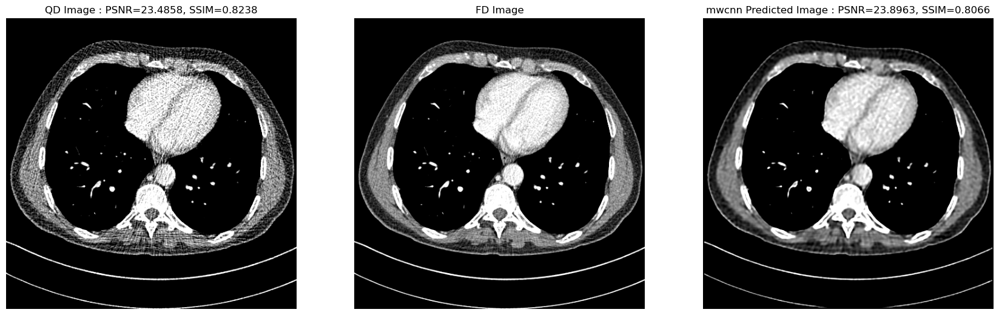

(512, 512, 1) (512, 512, 1)


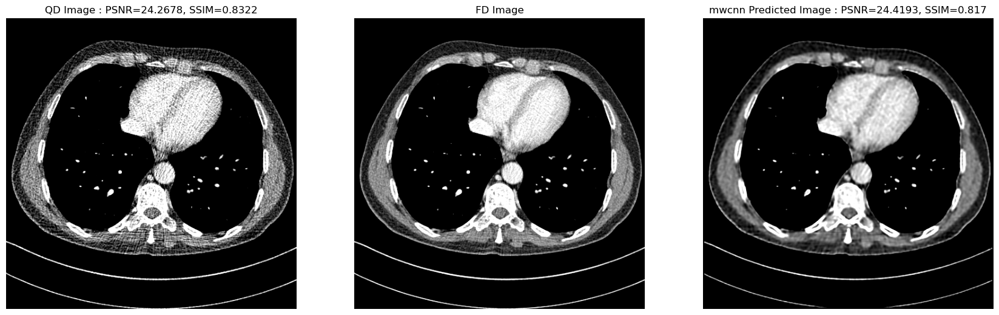

(512, 512, 1) (512, 512, 1)


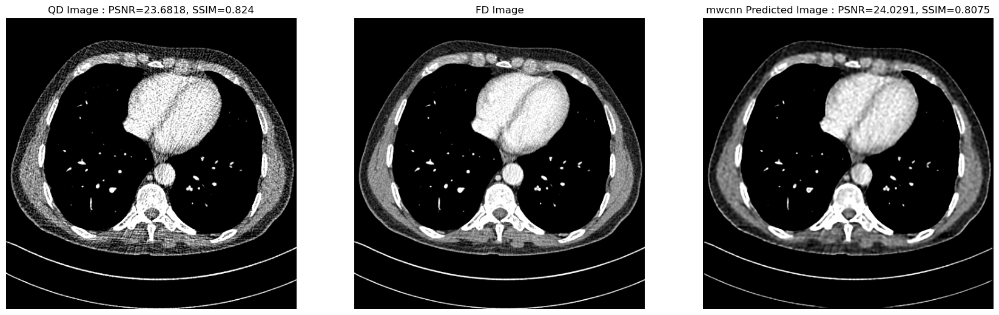

(512, 512, 1) (512, 512, 1)


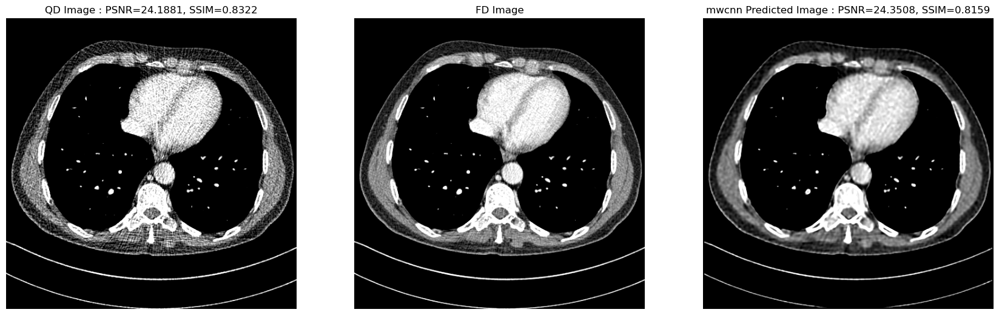

(512, 512, 1) (512, 512, 1)


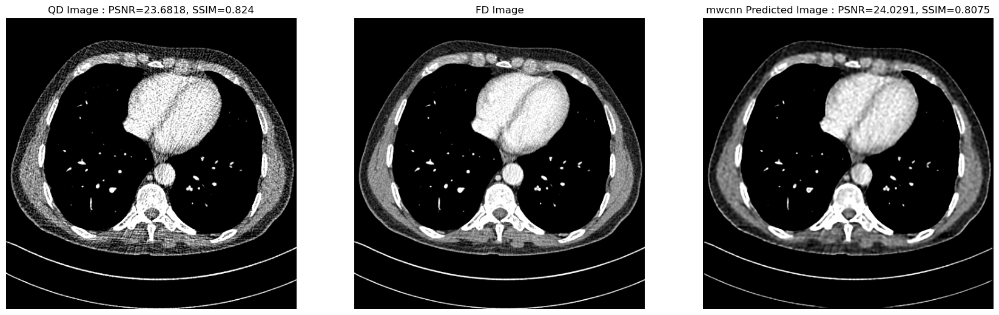

In [57]:
visualize_predictions(mwcnn_model, noisy_array, gt_array, len(gt_array), mwcnn_predictions, "mwcnn")

In [58]:
get_average_metrics(mwcnn_predictions)

Original average gt-noisy PSNR -> 23.5987675969538
Predicted average gt-predicted PSNR -> 24.157750387694502
Original average gt-noisy SSIM -> 0.8120425476373619
Predicted average gt-predicted SSIM -> 0.7892579892456694
